In [1]:
!pip install anvil-uplink
# !pip install pgmpy

  Using cached argparse-1.4.0-py2.py3-none-any.whl (23 kB)


In [2]:
# from google.colab import files
# file=files.upload()

In [3]:
# !unzip PGM_Project.zip

In [4]:
import anvil.server

In [5]:
anvil.server.connect("QCH763PK6D7X3PIIWQ355H5L-O3UMHGEUAHTCYLMK")

Connecting to wss://anvil.works/uplink
Anvil websocket open
Connected to "Default environment" as SERVER


In [6]:
from pgmpy.factors.discrete import TabularCPD
from pgmpy.models import BayesianNetwork

/home/kshek/anaconda3/lib/python3.9/site-packages/torch/cuda/__init__.py:83: UserWarning: CUDA initialization: CUDA unknown error - this may be due to an incorrectly set up environment, e.g. changing env variable CUDA_VISIBLE_DEVICES after program start. Setting the available devices to be zero. (Triggered internally at  ../c10/cuda/CUDAFunctions.cpp:109.)
  return torch._C._cuda_getDeviceCount() > 0


In [7]:
import networkx as nx
import matplotlib.pyplot as plt
from IPython.display import Image, display

# Setting up Model Structure
Here we define the connections between edges that the authors in the paper have worked out for us

### Features:

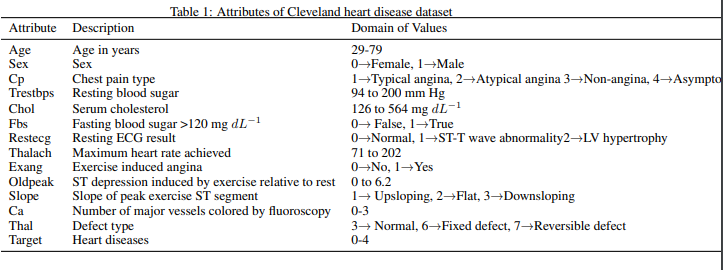

In [8]:
from IPython.display import Image
Image('Features_desc.png')

### BayesNet Structure

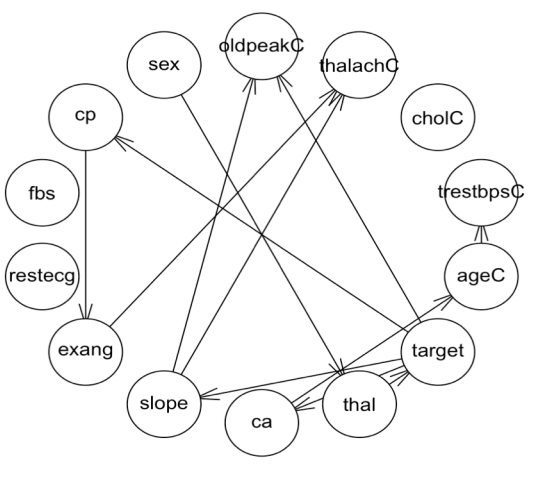

In [9]:
Image('bayes_net.png')

In [10]:
model=BayesianNetwork([('age','trestbps'),('sex','thal'),
                     ('cp','exang'),('exang','thalach'),
                     ('slope','oldpeak'),('slope','thalach'),
                     ('ca','age'),('thal','target'),
                     ('target','ca'),('target','cp'),('target','oldpeak'),('target','slope')])

In [11]:
model.add_node('chol')

In [12]:
model.add_node('fbs')

In [13]:
model.add_node('restecg')

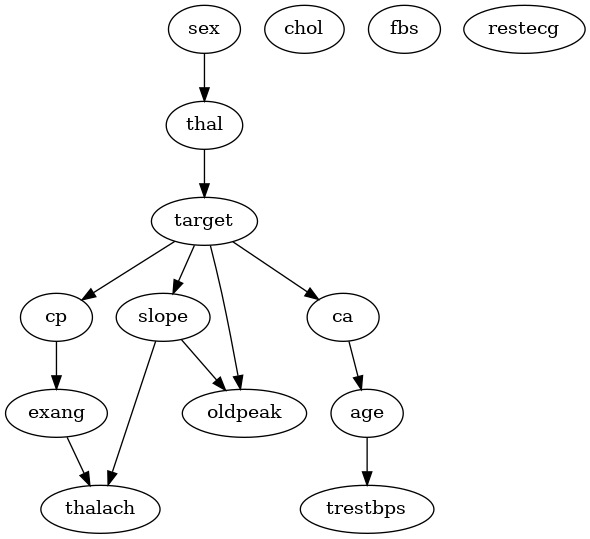

In [14]:
display(Image((nx.drawing.nx_pydot.to_pydot(model)).create_png()))

### CPDs for 12 variables

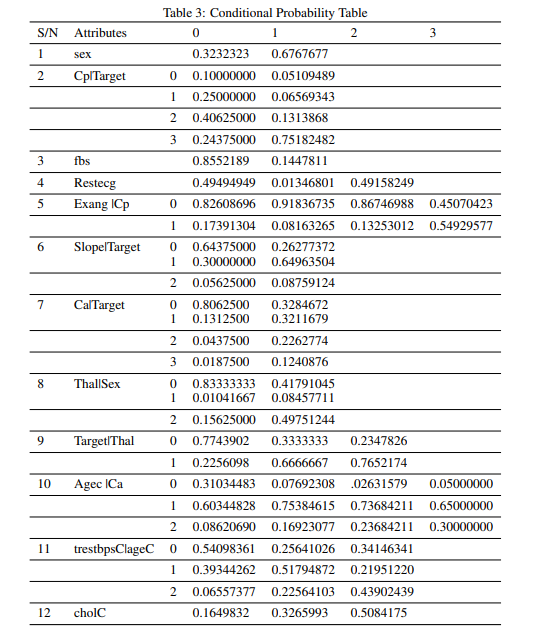

In [15]:
Image('cpd_12.png')

### Add the CPDs

In pgmpy the `columns are the evidences` and `rows are the states of the variable`

In [16]:
# 1 sex
sex_cpd=TabularCPD(variable='sex',variable_card=2,values=[[0.3232323],[0.6767677]])

In [17]:
# 2 cp|target
cp_cpd=TabularCPD(variable='cp',variable_card=4,values=[[0.10000000, 0.05109489],
                                                        [0.25000000, 0.06569343],
                                                        [0.40625000, 0.1313868],
                                                        [0.24375000, 0.75182482]],evidence=['target'],
                                                         evidence_card=[2])

In [18]:
# 3 fbs
fbs_cpd=TabularCPD(variable='fbs',variable_card=2,values=[[0.8552189],[0.1447811]])

In [19]:
# 4 restecg
restecg_cpd=TabularCPD(variable='restecg',variable_card=3,values=[[0.49494949],[0.01346801], [0.49158249]])

In [20]:
# 5 exang|cp
exang_cpd=TabularCPD(variable='exang',variable_card=2,values=[[ 0.82608696,0.91836735,0.86746988,0.45070423],
                                                              [0.17391304,0.08163265,0.13253012,0.54929577]],
                                                                evidence=['cp'],evidence_card=[4])

In [21]:
# 6 slope|target
slope_cpd=TabularCPD(variable='slope',variable_card=3,values=[[0.64375000, 0.26277372],
                                                              [0.30000000, 0.64963504],
                                                              [0.05625000,0.08759124]],
                                                               evidence=['target'],evidence_card=[2])

In [22]:
# 7 ca|target
ca_cpd=TabularCPD(variable='ca',variable_card=4,values=[[0.8062500, 0.3284672],
                                                          [0.1312500, 0.3211679],
                                                          [0.0437500, 0.2262774],
                                                          [0.0187500, 0.1240876],
                                                         ],evidence=['target'],evidence_card=[2])

In [23]:
# 8 thal|sex
thal_cpd=TabularCPD(variable='thal',variable_card=3,values=[[0.83333333, 0.41791045],
                                                          [ 0.01041667, 0.08457711],
                                                          [ 0.15625000, 0.49751244]
                                                         ],evidence=['sex'],evidence_card=[2])

In [24]:
# 9 target|thal
target_cpd=TabularCPD(variable='target',variable_card=2,values=[[0.7743902, 0.3333333, 0.2347826],
                                                                [0.2256098, 0.6666667, 0.7652174],
                                                         ],evidence=['thal'],evidence_card=[3])

In [25]:
#10 age|ca
age_cpd=TabularCPD(variable='age',variable_card=3,values=[[0.31034483,0.07692308,0.02631579,0.05000000],
                                                          [0.60344828,0.75384615,0.73684211,0.65000000],
                                                          [ 0.08620690,0.16923077,0.23684211,0.30000000]],
                                                        evidence=['ca'],evidence_card=[4])

In [26]:
# 11 trestbps|age
trestbps_cpd=TabularCPD(variable='trestbps',variable_card=3,values=[[ 0.54098361,0.25641026,0.34146341],
                                                                    [ 0.39344262,0.51794872,0.21951220],
                                                                    [ 0.06557377,0.22564103,0.43902439]],
                                                        evidence=['age'],evidence_card=[3])

In [27]:
# 12 chol
chol_cpd=TabularCPD(variable='chol',variable_card=3,values=[[0.1649832], [0.3265993], [0.5084175]])

### CPD for Thalach variable

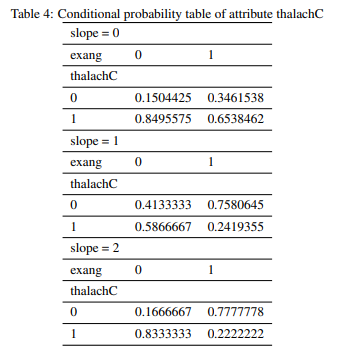

In [28]:
Image('cpd_thalch_C.png')

In [29]:
# P(thalach | slope, exang):
# +------+------+------+------+------+------+------+------+------+------+-------------+----------------+
# |     slope |               0             |             1             |             2                |
# +------+------+------+------+------+------+------+------+------+------+----------------+-------------+
# |     exang |        0      |       1     |      0      |      1      |          0     |   1         |
# +------+------+------+------+------+------+------+------+------+------+----------------+-------------+
# | thalach=0 |   0.1504425   |  0.3461538  | 0.4133333   |  0.7580645  |     0.1666667  |  0.7777778  |
# +------+------+------+------+------+------+------+------+------+------+----------------+-------------+
# | thalach=1 |   0.8495575   |  0.6538462  | 0.5866667   |   0.2419355 |     0.8333333  | 0.2222222   |
# +------+------+------+------+------+------+------+------+------+------+----------------+-------------+


In [30]:
#thalach|slope,exang
thalach_cpd=TabularCPD(variable='thalach',variable_card=2,
                      
                      values=[
                          [0.1504425,0.3461538,0.4133333,0.7580645,0.1666667,0.7777778],
                          [0.8495575,0.6538462,0.5866667,0.2419355,0.8333333,0.2222222]
                      ],evidence=['exang','slope'],evidence_card=[2,3])

In [31]:
model.get_parents('thalach')

['exang', 'slope']

### CPD for oldpeak variable

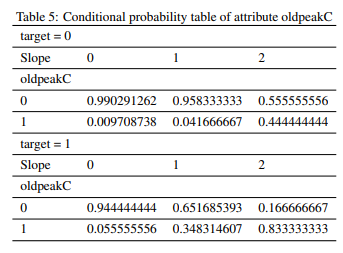

In [32]:
Image('cpd_olpeak.png')

<!-- P(oldpeak | slope, target):
+-------------+-------------+-----------+-----------+-------------+----------------+--------------+
|     target  |                    0                |                          1                  |
+-------------+-------------+-----------+-----------+-------------+----------------+--------------+
|     slope   |        0    |     1     |      2    |      0      |      1         |      2       |
+-------------+------+------+-----------+-----------+-------------+------+---------+--------------+
| oldpeak=0   |  0.990291262|0.958333333|0.555555556| 0.944444444 |  0.651685393   |  0.166666667 |
+-------------+------+------+-----------+-----------+-------------+----------------+--------------+
| oldpeak=1   |  0.009708738|0.041666667|0.444444444| 0.055555556 |  0.348314607   |  0.833333333 |
+-------------+-------------+-----------+-----------+-------------+----------------+--------------+ -->

In [33]:
#oldpeak|target,slope
oldpeak_cpd=TabularCPD(variable='oldpeak',variable_card=2,
                      
                      values=[
                          [0.990291262,0.958333333,0.555555556,0.944444444,0.651685393,0.166666667],
                          [0.009708738,0.041666667,0.444444444,0.055555556,0.348314607,0.833333333]
                      ],evidence=['target','slope'],evidence_card=[2,3])

In [34]:
model.get_parents('oldpeak')

['slope', 'target']

In [35]:
model.add_cpds(sex_cpd,cp_cpd,fbs_cpd,restecg_cpd,exang_cpd,slope_cpd,ca_cpd,thal_cpd,target_cpd,age_cpd,
               trestbps_cpd,chol_cpd,thalach_cpd,oldpeak_cpd)

In [36]:
model.get_parents('thalach')

['exang', 'slope']

In [37]:
model.check_model()

True

### `model` is now ready for inference

but let's experiment with the dataset ourselves and use structure and parameter learning on the data

In [38]:
import pandas as pd
import numpy as np

In [39]:
df=pd.read_csv('heart_cleveland_upload.csv')

In [40]:
df.rename(columns = {'condition':'target'}, inplace = True)

In [41]:
df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,69,1,0,160,234,1,2,131,0,0.1,1,1,0,0
1,69,0,0,140,239,0,0,151,0,1.8,0,2,0,0
2,66,0,0,150,226,0,0,114,0,2.6,2,0,0,0
3,65,1,0,138,282,1,2,174,0,1.4,1,1,0,1
4,64,1,0,110,211,0,2,144,1,1.8,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,40,1,3,152,223,0,0,181,0,0.0,0,0,2,1
293,39,1,3,118,219,0,0,140,0,1.2,1,0,2,1
294,35,1,3,120,198,0,0,130,1,1.6,1,0,2,1
295,35,0,3,138,183,0,0,182,0,1.4,0,0,0,0


In [42]:
df.isna().sum() #no missing values in this dataset

age         0
sex         0
cp          0
trestbps    0
chol        0
fbs         0
restecg     0
thalach     0
exang       0
oldpeak     0
slope       0
ca          0
thal        0
target      0
dtype: int64

#### We have to Discretize our dataset's 5 continous features: age, trestbps, chol, thalach, and oldpeak

In [43]:
def preprocessing_pipeline(age,trestbps,chol,thalach,oldpeak):
    """Only takes care of 5 continous cases, categorizing them"""
    if age>=29 and age<=45:
        age=0
    elif age>45 and age<=62:
        age=1
    elif age>62 and age<=79:
        age=2
    if trestbps>=94 and trestbps<=129:
        trestbps=0
    elif trestbps>129 and trestbps<=165:
        trestbps=1
    elif trestbps>165 and trestbps<=200:
        trestbps=2
    if chol>=126 and chol<=272:
        chol=0
    elif chol>272 and chol<=419:
        chol=1
    elif chol>419 and chol<=564:
        chol=2
    if thalach>=71 and thalach<=131:
        thalach=0
    elif thalach>131 and thalach<=202:
        thalach=1
    if oldpeak>=0.0 and oldpeak<=3.1:
        oldpeak=0
    elif oldpeak>3.1 and oldpeak<=6.2:
        oldpeak=1
        
    return age,trestbps,chol,thalach,oldpeak
      

In [44]:
for index,row in df.iterrows():
    df.age.iloc[index],df.trestbps.iloc[index],df.chol.iloc[index],df.thalach.iloc[index],df.oldpeak.iloc[index] = preprocessing_pipeline(row['age'],row['trestbps'],row['chol'],row['thalach'],row['oldpeak'])

/tmp/ipykernel_292499/3929308066.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.age.iloc[index],df.trestbps.iloc[index],df.chol.iloc[index],df.thalach.iloc[index],df.oldpeak.iloc[index] = preprocessing_pipeline(row['age'],row['trestbps'],row['chol'],row['thalach'],row['oldpeak'])


In [45]:
df.isna().sum()

age         0
sex         0
cp          0
trestbps    0
chol        0
fbs         0
restecg     0
thalach     0
exang       0
oldpeak     0
slope       0
ca          0
thal        0
target      0
dtype: int64

In [46]:
df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,2,1,0,1,0,1,2,0,0,0.0,1,1,0,0
1,2,0,0,1,0,0,0,1,0,0.0,0,2,0,0
2,2,0,0,1,0,0,0,0,0,0.0,2,0,0,0
3,2,1,0,1,1,1,2,1,0,0.0,1,1,0,1
4,2,1,0,0,0,0,2,1,1,0.0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,0,1,3,1,0,0,0,1,0,0.0,0,0,2,1
293,0,1,3,0,0,0,0,1,0,0.0,1,0,2,1
294,0,1,3,0,0,0,0,0,1,0.0,1,0,2,1
295,0,0,3,1,0,0,0,1,0,0.0,0,0,0,0


### Discretization and missing values imputation is done

In [47]:
from IPython.display import Image, display
from pgmpy.estimators import HillClimbSearch, BicScore, PC, K2Score
from pgmpy.estimators import BayesianEstimator,MaximumLikelihoodEstimator,ExpectationMaximization,StructureEstimator

In [48]:
# Create a checkpoint
df.to_csv('heart_cleveland_upload_encoded.csv')
df

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
0,2,1,0,1,0,1,2,0,0,0.0,1,1,0,0
1,2,0,0,1,0,0,0,1,0,0.0,0,2,0,0
2,2,0,0,1,0,0,0,0,0,0.0,2,0,0,0
3,2,1,0,1,1,1,2,1,0,0.0,1,1,0,1
4,2,1,0,0,0,0,2,1,1,0.0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
292,0,1,3,1,0,0,0,1,0,0.0,0,0,2,1
293,0,1,3,0,0,0,0,1,0,0.0,1,0,2,1
294,0,1,3,0,0,0,0,0,1,0.0,1,0,2,1
295,0,0,3,1,0,0,0,1,0,0.0,0,0,0,0


In [49]:
#split intro training and testing sets
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(df.drop('target',axis=1),df.target,test_size=0.2,random_state=42)
len(X_train),len(X_test),len(y_train),len(y_test)


(237, 60, 237, 60)

In [50]:
X_train.shape,X_test.shape

((237, 13), (60, 13))

In [51]:
y_train.shape,y_test.shape

((237,), (60,))

In [52]:
type(X_train),type(y_train)#X_train,X_test are dfs while y_train,y_test are series objects

(pandas.core.frame.DataFrame, pandas.core.series.Series)

In [53]:
#concatenate the X_train,y_train into df_train and X_test,y_test intro df_test
df_train=pd.concat([X_train,y_train],axis=1)
df_train

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
273,1,1,3,1,1,0,0,0,1,0.0,1,2,2,1
259,1,0,3,1,1,0,0,1,1,0.0,1,0,2,1
30,1,1,1,1,0,0,0,1,1,0.0,0,0,0,0
22,0,1,0,0,0,0,2,1,0,0.0,0,0,0,0
277,0,1,3,1,1,0,2,1,1,0.0,1,3,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,1,0,3,1,1,0,2,1,0,0.0,1,0,0,0
71,0,1,1,1,0,0,2,1,0,0.0,0,0,0,0
106,1,1,2,1,0,1,2,1,1,0.0,1,1,1,1
270,1,1,3,0,1,0,2,0,1,0.0,1,1,0,1


In [54]:
df_test=pd.concat([X_test,y_test],axis=1)
df_test

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
167,2,0,3,2,0,1,0,1,1,0.0,1,2,2,1
211,1,1,3,1,0,0,0,1,1,0.0,0,1,2,1
63,0,1,1,1,0,0,0,1,0,0.0,1,0,1,0
154,0,0,2,0,0,0,0,1,0,0.0,0,0,0,0
5,2,1,0,2,0,0,2,1,0,0.0,1,0,2,0
77,2,0,2,0,0,0,2,0,0,0.0,1,0,0,0
183,2,1,3,1,1,1,2,1,1,0.0,0,3,2,1
158,2,1,3,1,1,0,2,0,0,0.0,1,3,0,1
9,1,1,0,2,0,0,2,1,0,1.0,2,0,2,0
139,0,1,2,1,0,0,0,1,1,0.0,0,0,0,0


### Structure learning 

We'll perform structure learning on the whole dataset, and parameter learning with a training set comprising 70% of the total dataset
And we'll test out the accuracy of the model using the test set comprising the remaining 30% of the total dataset.


  0%|          | 0/1000000 [00:00<?, ?it/s]

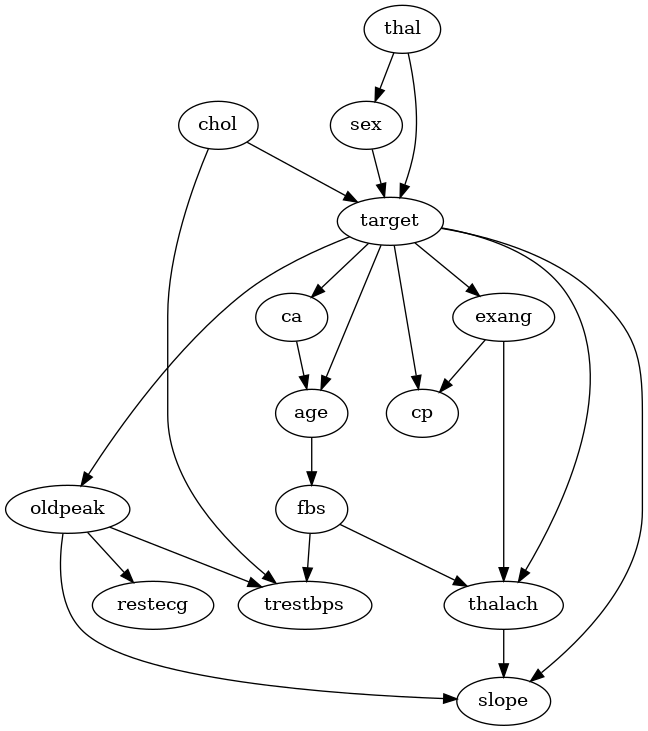

In [55]:
hc1 = HillClimbSearch(df, K2Score(df))
est_model = hc1.estimate()
display(Image((nx.drawing.nx_pydot.to_pydot(est_model)).create_png()))

In [56]:
est_model.get_parents('slope')

['target', 'thalach', 'oldpeak']

In [57]:
model.get_parents('slope')

['target']

In [58]:
model

In [59]:
est_model=BayesianNetwork(est_model)#convert DAG object to BN object

In [60]:
est_model

### Parameter learning on df_train

In [61]:
est_model.fit(df_train, estimator=BayesianEstimator, prior_type="BDeu")

In [62]:
est_model.check_model()

True

In [63]:
est_model.get_independencies()

(slope ⟂ restecg | oldpeak)
(slope ⟂ chol, sex, thal | target)
(slope ⟂ restecg | cp, oldpeak)
(slope ⟂ chol, sex, thal | cp, target)
(slope ⟂ restecg | trestbps, oldpeak)
(slope ⟂ restecg | thalach, oldpeak)
(slope ⟂ restecg | thal, oldpeak)
(slope ⟂ restecg | age, oldpeak)
(slope ⟂ restecg | ca, oldpeak)
(slope ⟂ chol, sex, thal, restecg | target, oldpeak)
(slope ⟂ restecg | fbs, oldpeak)
(slope ⟂ restecg | chol, oldpeak)
(slope ⟂ restecg | exang, oldpeak)
(slope ⟂ restecg | sex, oldpeak)
(slope ⟂ cp, exang, thal, age, fbs, chol, ca, sex | thalach, target)
(slope ⟂ chol, sex | thal, target)
(slope ⟂ ca, sex, thal, chol | age, target)
(slope ⟂ chol, sex, thal | ca, target)
(slope ⟂ chol, sex, ca, thal, age | fbs, target)
(slope ⟂ sex, thal | chol, target)
(slope ⟂ chol, cp, thal, sex | exang, target)
(slope ⟂ chol, thal | sex, target)
(slope ⟂ chol, sex, thal | target, restecg)
(slope ⟂ restecg | cp, trestbps, oldpeak)
(slope ⟂ restecg | thalach, cp, oldpeak)
(slope ⟂ restecg | cp, th

In [64]:
model.get_independencies()

(slope ⟂ chol, fbs, restecg)
(slope ⟂ chol, fbs, restecg | trestbps)
(slope ⟂ exang, fbs, restecg, chol | cp)
(slope ⟂ chol, fbs, restecg | oldpeak)
(slope ⟂ chol, fbs, restecg | thalach)
(slope ⟂ chol, fbs, restecg | exang)
(slope ⟂ chol, sex, fbs, restecg | thal)
(slope ⟂ chol, trestbps, fbs, restecg | age)
(slope ⟂ trestbps, cp, thal, age, ca, fbs, chol, exang, sex, restecg | target)
(slope ⟂ chol, restecg | fbs)
(slope ⟂ fbs, restecg | chol)
(slope ⟂ trestbps, fbs, chol, age, restecg | ca)
(slope ⟂ chol, fbs, restecg | sex)
(slope ⟂ chol, fbs | restecg)
(slope ⟂ exang, fbs, restecg, chol | trestbps, cp)
(slope ⟂ chol, fbs, restecg | trestbps, oldpeak)
(slope ⟂ chol, fbs, restecg | thalach, trestbps)
(slope ⟂ chol, fbs, restecg | exang, trestbps)
(slope ⟂ chol, sex, fbs, restecg | trestbps, thal)
(slope ⟂ chol, fbs, restecg | trestbps, age)
(slope ⟂ cp, thal, age, ca, fbs, chol, exang, sex, restecg | trestbps, target)
(slope ⟂ chol, restecg | trestbps, fbs)
(slope ⟂ fbs, restecg | c

In [65]:
len(df_test)

60

In [66]:
model.get_cpds()

[<TabularCPD representing P(sex:2) at 0x7fdc45375730>,
 <TabularCPD representing P(cp:4 | target:2) at 0x7fdc453755e0>,
 <TabularCPD representing P(fbs:2) at 0x7fdc45375c10>,
 <TabularCPD representing P(restecg:3) at 0x7fdc45375cd0>,
 <TabularCPD representing P(exang:2 | cp:4) at 0x7fdc4537e220>,
 <TabularCPD representing P(slope:3 | target:2) at 0x7fdc4537ec70>,
 <TabularCPD representing P(ca:4 | target:2) at 0x7fdc4537ecd0>,
 <TabularCPD representing P(thal:3 | sex:2) at 0x7fdc4537ef10>,
 <TabularCPD representing P(target:2 | thal:3) at 0x7fdc4537e190>,
 <TabularCPD representing P(age:3 | ca:4) at 0x7fdc4537ebb0>,
 <TabularCPD representing P(trestbps:3 | age:3) at 0x7fdc4537ed90>,
 <TabularCPD representing P(chol:3) at 0x7fdc4538d4f0>,
 <TabularCPD representing P(thalach:2 | exang:2, slope:3) at 0x7fdc4537efa0>,
 <TabularCPD representing P(oldpeak:2 | target:2, slope:3) at 0x7fdc4538d970>]

In [67]:
est_model.get_cpds()

[<TabularCPD representing P(age:3 | ca:4, target:2) at 0x7fdc3c5a54c0>,
 <TabularCPD representing P(sex:2 | thal:3) at 0x7fdc3ee2b5b0>,
 <TabularCPD representing P(cp:4 | exang:2, target:2) at 0x7fdc3ee4f670>,
 <TabularCPD representing P(trestbps:3 | chol:3, fbs:2, oldpeak:2) at 0x7fdc3ee4f280>,
 <TabularCPD representing P(chol:3) at 0x7fdc3ede7a00>,
 <TabularCPD representing P(fbs:2 | age:3) at 0x7fdc3ede72e0>,
 <TabularCPD representing P(restecg:3 | oldpeak:2) at 0x7fdc3c5a1250>,
 <TabularCPD representing P(thalach:2 | exang:2, fbs:2, target:2) at 0x7fdc3edee130>,
 <TabularCPD representing P(exang:2 | target:2) at 0x7fdc3ee47430>,
 <TabularCPD representing P(oldpeak:2 | target:2) at 0x7fdc3ee49790>,
 <TabularCPD representing P(slope:3 | oldpeak:2, target:2, thalach:2) at 0x7fdc3ee49fd0>,
 <TabularCPD representing P(ca:4 | target:2) at 0x7fdc3ee47400>,
 <TabularCPD representing P(thal:3) at 0x7fdc3ee343a0>,
 <TabularCPD representing P(target:2 | chol:3, sex:2, thal:3) at 0x7fdc3ee4713

### Find active trail nodes

In [68]:
#model
model.active_trail_nodes('target')

{'target': {'age',
  'ca',
  'cp',
  'exang',
  'oldpeak',
  'sex',
  'slope',
  'target',
  'thal',
  'thalach',
  'trestbps'}}

In [69]:
est_model.active_trail_nodes('target')

{'target': {'age',
  'ca',
  'chol',
  'cp',
  'exang',
  'fbs',
  'oldpeak',
  'restecg',
  'sex',
  'slope',
  'target',
  'thal',
  'thalach',
  'trestbps'}}

### Find local independencies

In [70]:
model.local_independencies('target')

(target ⟂ chol, sex, fbs, restecg | thal)

In [71]:
est_model.local_independencies('target')


### Find out the accuracy of both the models

In [72]:
from pgmpy.inference import VariableElimination

In [73]:
def accuracy_precision_recall(df_test,model):
    target_inference=VariableElimination(model)
    true_negative,true_positive,false_negative,false_postive=0,0,0,0
    truth_values={k:v for k,v in zip(list(df_test.index),list(df_test.target))}
    df_test=df_test.drop('target',axis=1)
    for index,row in df_test.iterrows():
        cols=[col for col in df_test.columns]
        evidence_dict={k:v for k,v in zip(cols,list(df_test.loc[index][cols]))}
        prediction=target_inference.map_query(['target'],evidence=evidence_dict)
        if truth_values[index]==prediction['target']:
            if truth_values[index]==0:
                true_negative+=1
            else:
                true_positive+=1
        #FalsePositives
        elif truth_values[index]==0 and prediction['target']==1:
            false_postive+=1
        #FalseNegatives
        elif truth_values[index]==1 and prediction['target']==0:
            false_negative+=1
                
    return [(true_positive+true_negative)/len(df_test),true_positive/(true_positive+false_postive),
               true_positive/(true_positive+false_negative)]#accuracy,precision,recall

In [74]:
accuracy_precision_recall(df_test,model)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

[0.8333333333333334, 0.8214285714285714, 0.8214285714285714]

In [75]:
accuracy_precision_recall(df_test,est_model)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

[0.8, 0.7857142857142857, 0.7857142857142857]

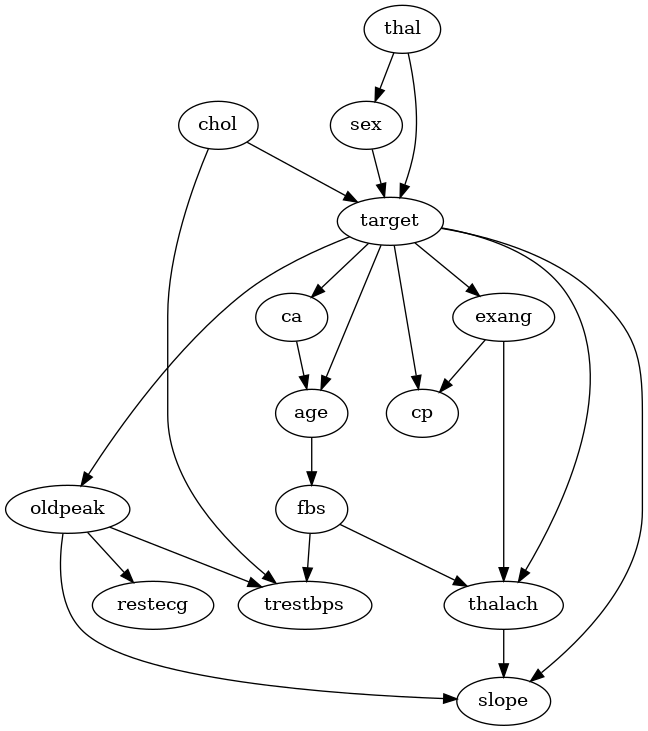

In [76]:
display(Image((nx.drawing.nx_pydot.to_pydot(est_model)).create_png()))

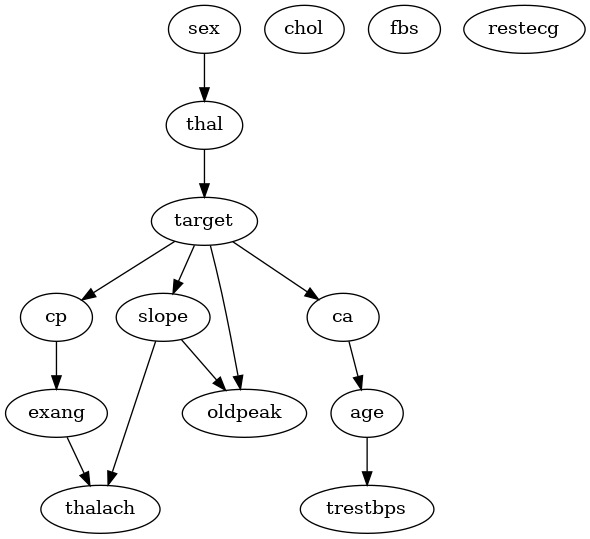

In [77]:
display(Image((nx.drawing.nx_pydot.to_pydot(model)).create_png()))

In [78]:
df_train

,age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal,target
273,1,1,3,1,1,0,0,0,1,0.0,1,2,2,1
259,1,0,3,1,1,0,0,1,1,0.0,1,0,2,1
30,1,1,1,1,0,0,0,1,1,0.0,0,0,0,0
22,0,1,0,0,0,0,2,1,0,0.0,0,0,0,0
277,0,1,3,1,1,0,2,1,1,0.0,1,3,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
188,1,0,3,1,1,0,2,1,0,0.0,1,0,0,0
71,0,1,1,1,0,0,2,1,0,0.0,0,0,0,0
106,1,1,2,1,0,1,2,1,1,0.0,1,1,1,1
270,1,1,3,0,1,0,2,0,1,0.0,1,1,0,1


### Structure learning on only the training set

  0%|          | 0/1000000 [00:00<?, ?it/s]

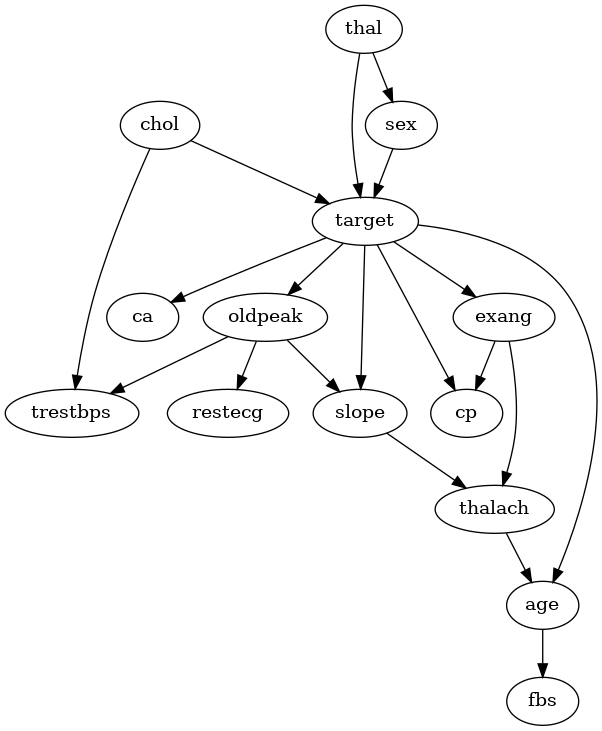

In [79]:
hc_train_set = HillClimbSearch(df_train, K2Score(df_train))
est_model_train_set = hc_train_set.estimate()
display(Image((nx.drawing.nx_pydot.to_pydot(est_model_train_set)).create_png()))

In [80]:
est_model_train_set=BayesianNetwork(est_model_train_set)

### Parameter Learning with different estimators on the training set, accuracy on test set

In [81]:
def accuracy_precision_recall(df_test,model):
    target_inference=VariableElimination(model)
    true_negative,true_positive,false_negative,false_postive=0,0,0,0
    truth_values={k:v for k,v in zip(list(df_test.index),list(df_test.target))}
    df_test=df_test.drop('target',axis=1)
    for index,row in df_test.iterrows():
        cols=[col for col in df_test.columns]
        evidence_dict={k:v for k,v in zip(cols,list(df_test.loc[index][cols]))}
        prediction=target_inference.map_query(['target'],evidence=evidence_dict)
        if truth_values[index]==prediction['target']:
            if truth_values[index]==0:
                true_negative+=1
            else:
                true_positive+=1
        #FalsePositives
        elif truth_values[index]==0 and prediction['target']==1:
            false_postive+=1
        #FalseNegatives
        elif truth_values[index]==1 and prediction['target']==0:
            false_negative+=1
                
    return [(true_positive+true_negative)/len(df_test),true_positive/(true_positive+false_postive),
               true_positive/(true_positive+false_negative)]#accuracy,precision,recall

In [82]:
est_model_train_set.fit(df_train)#MLE Estimator

In [83]:
accuracy_precision_recall(df_test,est_model_train_set)

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

0it [00:00, ?it/s]

[0.8166666666666667, 0.7931034482758621, 0.8214285714285714]

In [84]:
model.save('orginal_cvd_BN.xmlbif', filetype='xmlbif')

In [85]:
est_model.save('estimated_cvd_BN.xmlbif',filetype='xmlbif')

In [86]:
est_model_train_set.save('estimated_train_test_cvd_BN.xmlbif',filetype='xmlbif')

In [87]:
model = BayesianNetwork.load('orginal_cvd_BN.xmlbif', filetype='xmlbif')
print(model.check_model())              # check if CPDs are present
est_model=BayesianNetwork.load('estimated_cvd_BN.xmlbif',filetype='xmlbif')
print(est_model.check_model())
est_model_train_set=BayesianNetwork.load('estimated_train_test_cvd_BN.xmlbif',filetype='xmlbif')
print(est_model_train_set.check_model())

True
True
True


Some changes made to the code to incorporate anvil functionality:

In [88]:
def accuracy_precision_recall(df_test,model):
    target_inference=VariableElimination(model)
    true_negative,true_positive,false_negative,false_postive=0,0,0,0
    truth_values={k:v for k,v in zip(list(df_test.index),list(df_test.target))}
    df_test=df_test.drop('target',axis=1)
    for index,row in df_test.iterrows():
        cols=[col for col in df_test.columns]
        evidence_dict={k:v for k,v in zip(cols,list(df_test.loc[index][cols]))}
        prediction=target_inference.map_query(['target'],evidence=evidence_dict)
        if truth_values[index]==prediction['target']:
            if truth_values[index]==0:
                true_negative+=1
            else:
                true_positive+=1
        #FalsePositives
        elif truth_values[index]==0 and prediction['target']==1:
            false_postive+=1
        #FalseNegatives
        elif truth_values[index]==1 and prediction['target']==0:
            false_negative+=1
                
    return [(true_positive+true_negative)/len(df_test),true_positive/(true_positive+false_postive),
               true_positive/(true_positive+false_negative)]#accuracy,precision,recall

In [89]:
def preprocessing_pipeline(age,trestbps,chol,thalach,oldpeak):
    """Only takes care of 5 continous cases, categorizing them"""
  
    if age>=29 and age<=45:
        age=0
    elif age>45 and age<=62:
        age=1
    elif age>62 and age<=79:
        age=2
    if trestbps>=94 and trestbps<=129:
        trestbps=0
    elif trestbps>129 and trestbps<=165:
        trestbps=1
    elif trestbps>165 and trestbps<=200:
        trestbps=2
    if chol>=126 and chol<=272:
        chol=0
    elif chol>272 and chol<=419:
        chol=1
    elif chol>419 and chol<=564:
        chol=2
    if thalach>=71 and thalach<=131:
        thalach=0
    elif thalach>131 and thalach<=202:
        thalach=1
    if oldpeak>=0.0 and oldpeak<=3.1:
        oldpeak=0
    elif oldpeak>3.1 and oldpeak<=6.2:
        oldpeak=1
    return age,trestbps,chol,thalach,oldpeak
  

In [90]:
@anvil.server.callable
def predict(age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal):
    age,trestbps,chol,thalach,oldpeak=preprocessing_pipeline(age,trestbps,chol,thalach,oldpeak)
    target_inference=VariableElimination(est_model_train_set)
    cols=[col for col in df_test.columns if col!='target']
    evidence_dict={k:v for k,v in zip(cols,[age,sex,cp,trestbps,chol,fbs,restecg,thalach,exang,oldpeak,slope,ca,thal])}
    prediction=target_inference.map_query(variables=['target'],evidence=evidence_dict)
    return int(prediction['target'])

In [ ]:
anvil.server.wait_forever()

/home/kshek/anaconda3/lib/python3.9/site-packages/pgmpy/factors/discrete/DiscreteFactor.py:541: UserWarning: Found unknown state name. Trying to switch to using all state names as state numbers
  warnings.warn(


0it [00:00, ?it/s]

0it [00:00, ?it/s]